In [1]:
import pandas as pd
import scanpy
import scprep
import magic
import numpy as np
import matplotlib.pyplot as plt
from sklearn import preprocessing
import seaborn as sns

In [2]:
adata_beta = scanpy.read_h5ad('../data/beta_run_2.h5ad')

In [3]:
sns.set_style('white')
scanpy.set_figure_params(dpi_save=300)

## Dot Plot

In [4]:
markers = pd.read_csv('../data/dotplot_presentation_beta_cell_markers', dtype=str, header=None)
markers.columns = ['group', 'gene']

In [5]:
unique_groups = markers['group'].drop_duplicates().values

In [6]:
from collections import OrderedDict
markers_dict = OrderedDict()
for group in unique_groups:
    markers_dict[group] = list(markers[markers['group'] == group]['gene'])

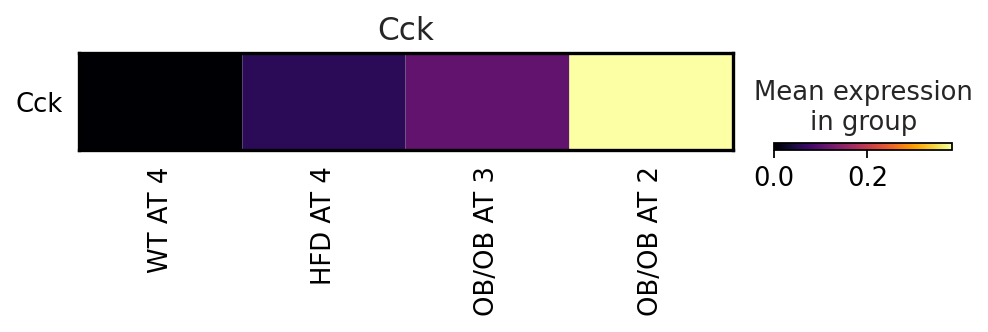

In [40]:
scanpy.pl.matrixplot(adata_beta[adata_beta.obs['AT_committment'].isin(['WT AT 4', 'HFD AT 4', 'OB/OB AT 3', 'OB/OB AT 2'])],
                         var_names=['Cck'],
                         figsize=(7,1*0.8),
                         gene_symbols='names',
                         categories_order= ['WT AT 4', 'HFD AT 4', 'OB/OB AT 3', 'OB/OB AT 2'],
                         groupby=['AT_committment'],
                         cmap='inferno',
                         title='Cck',
                         swap_axes=True, save=f'figures/immature_CCK_heatmap.png')

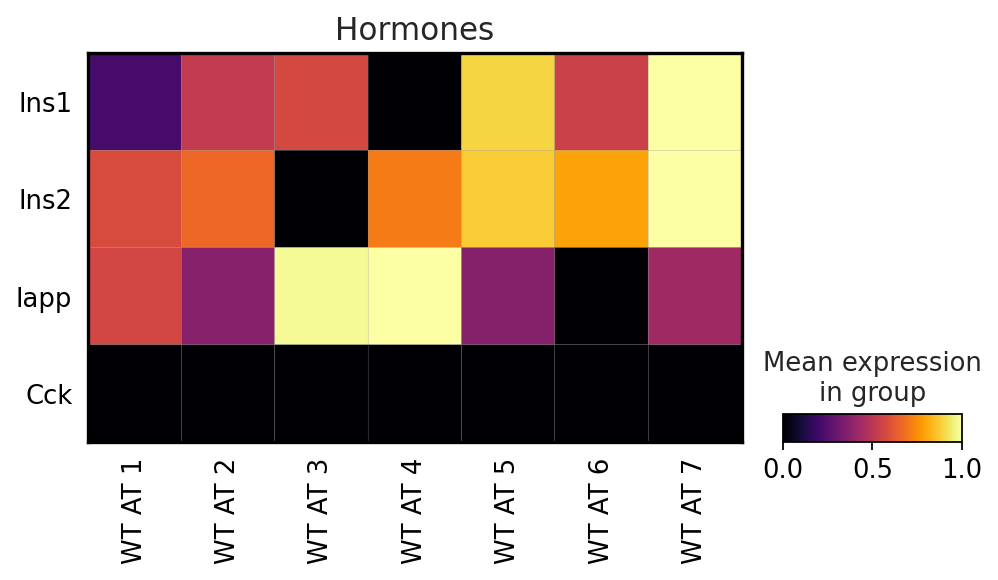

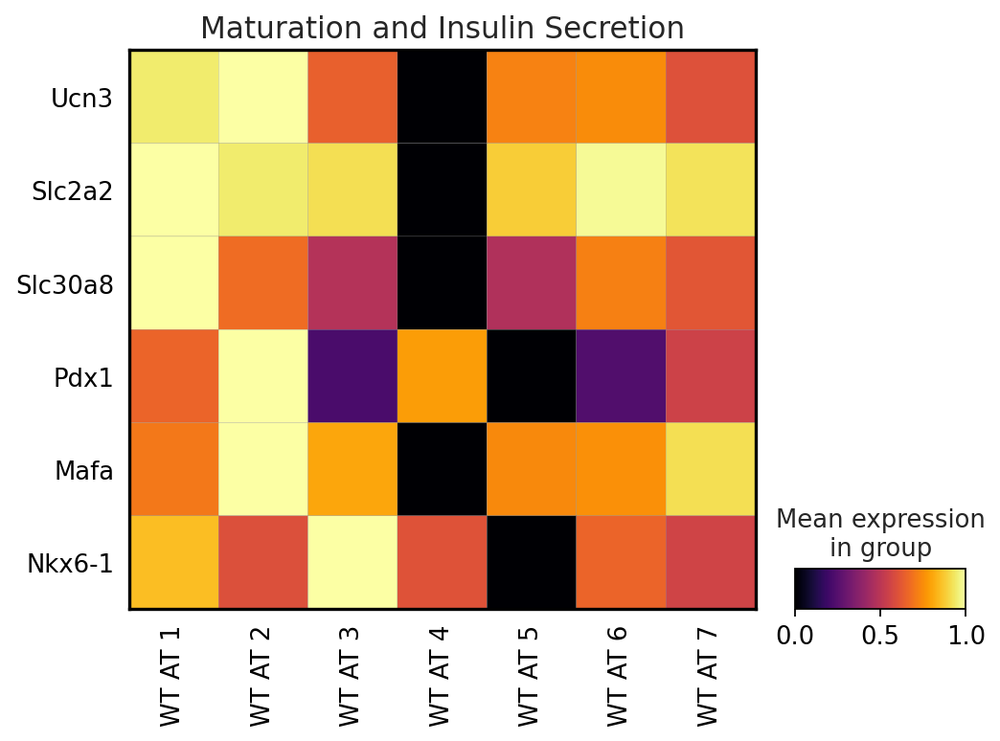

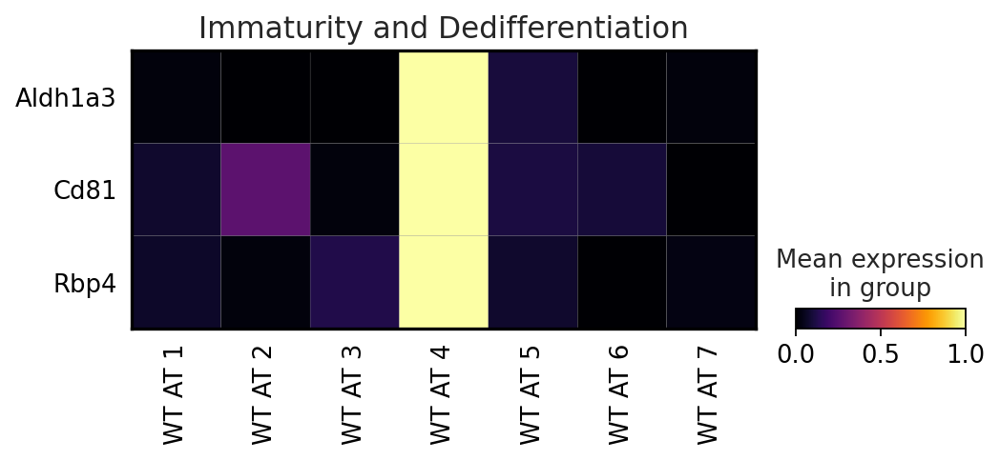

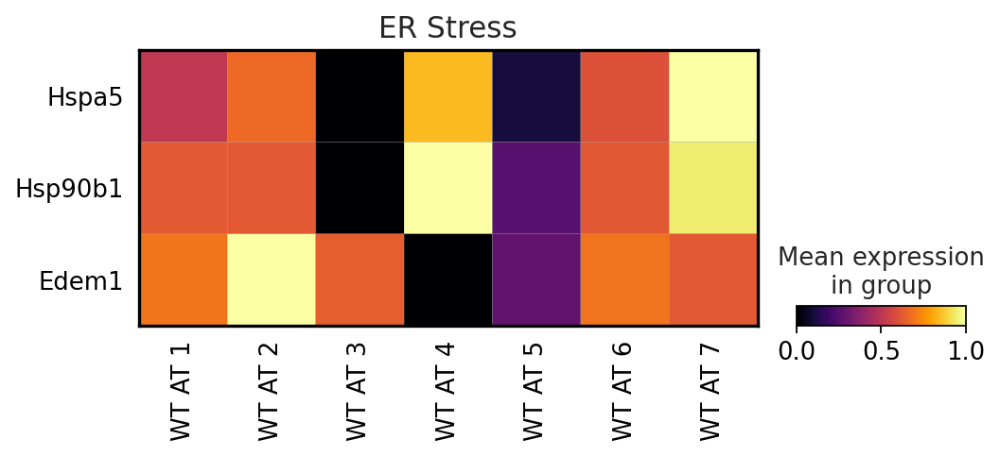

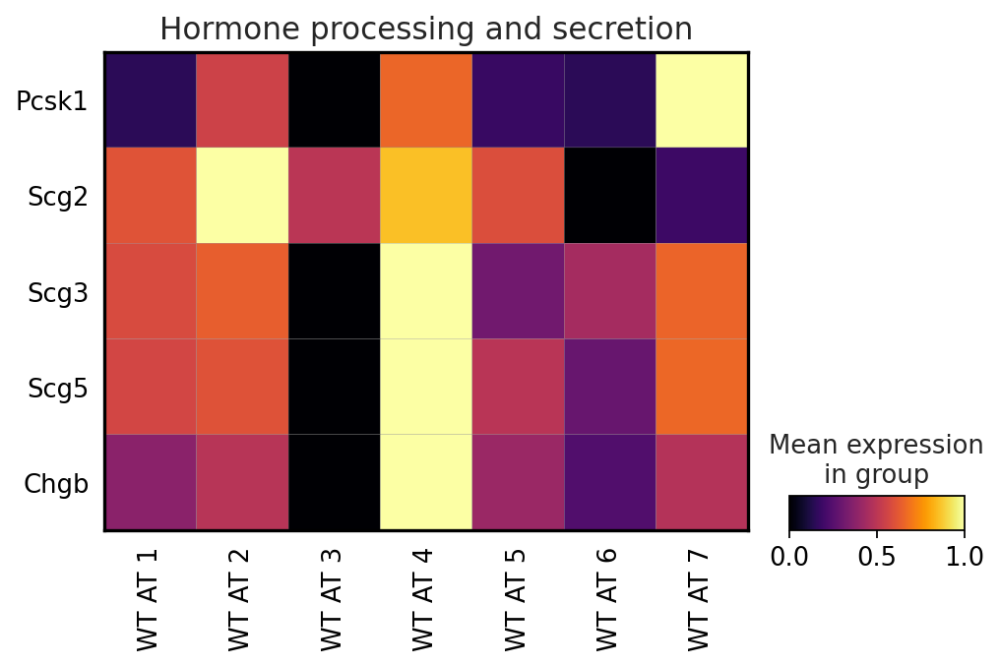

In [7]:
for key,vals in markers_dict.items():
    scanpy.pl.matrixplot(adata_beta[(adata_beta.obs['samples'] == 'WT') &
                                    (adata_beta.obs['AT_committment'] != 'Uncommitted')],
                         var_names=markers_dict[key],
                         figsize=(7,len(vals)*0.8),
                         gene_symbols='names',
                         groupby=['AT_committment'],
                         standard_scale='var', cmap='inferno',
                         title=key,
                         swap_axes=True, save=f'figures/WT_{key}_all_committed_cells.png')

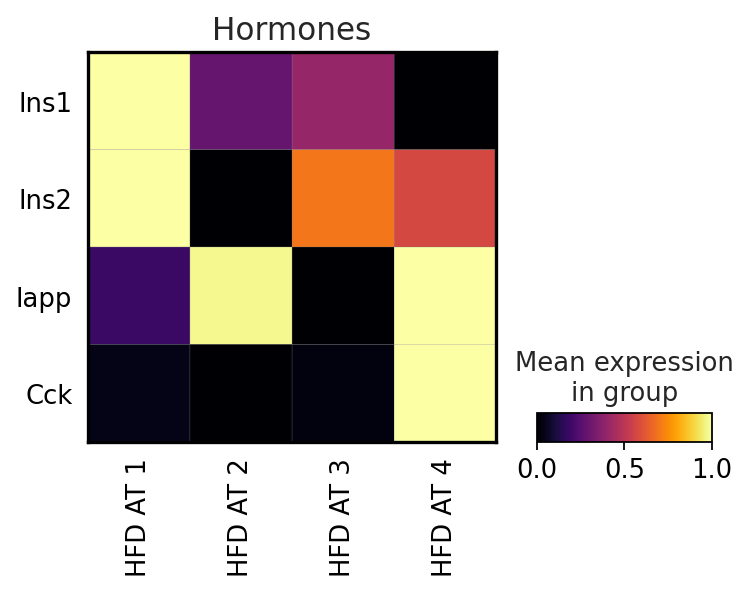

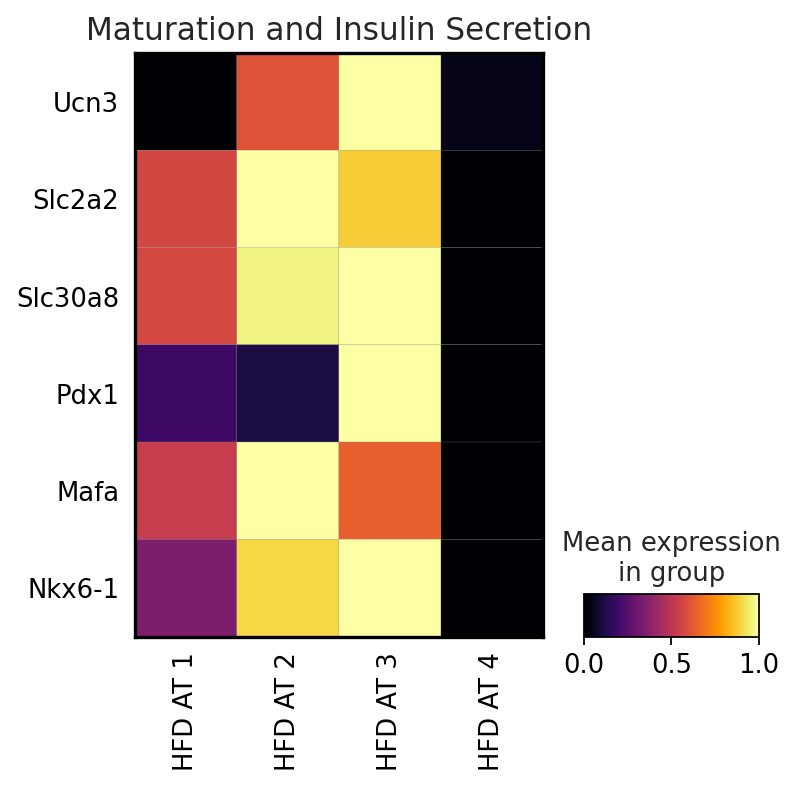

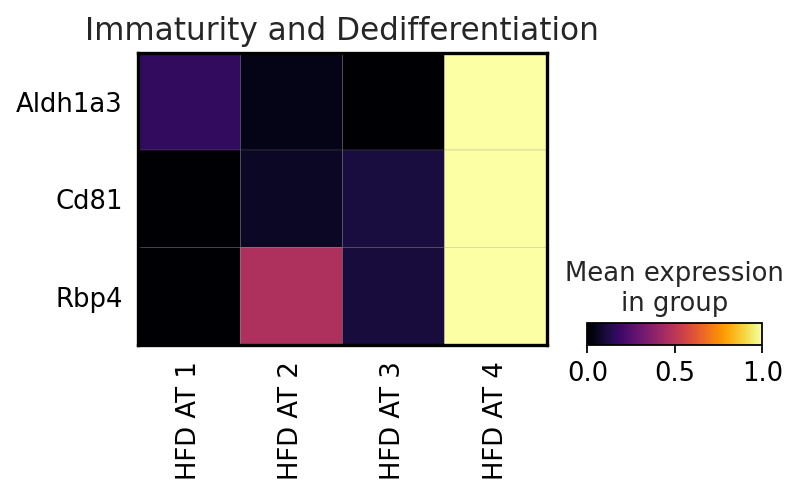

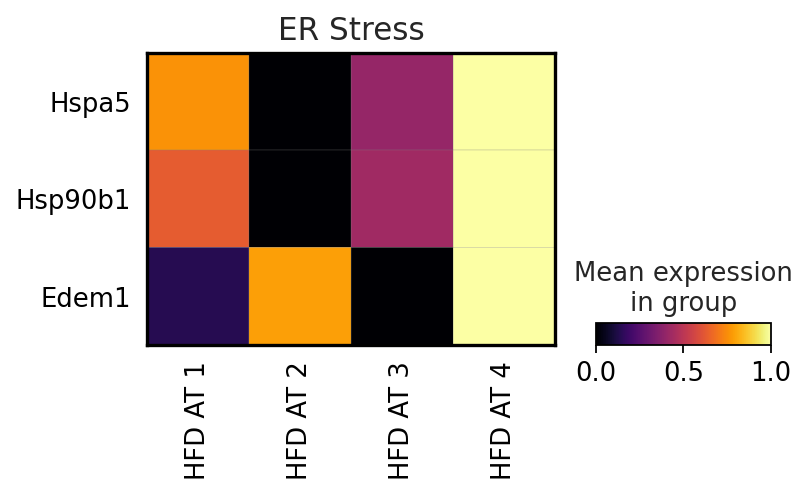

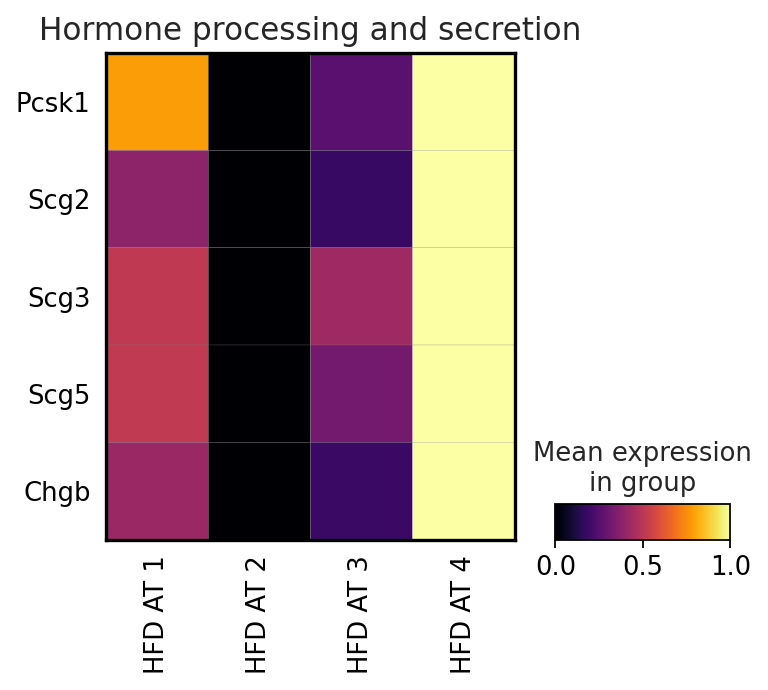

In [8]:
for key,vals in markers_dict.items():
    scanpy.pl.matrixplot(adata_beta[(adata_beta.obs['samples'] == 'HFD') &
                                    (adata_beta.obs['AT_committment'] != 'Uncommitted')],
                         var_names=markers_dict[key],
                         figsize=(5,len(vals)*0.8),
                         gene_symbols='names',
                         groupby=['AT_committment'],
                         standard_scale='var', cmap='inferno',
                         title=key,
                         swap_axes=True, save=f'figures/HFD_{key}_all_committed_cells.png')

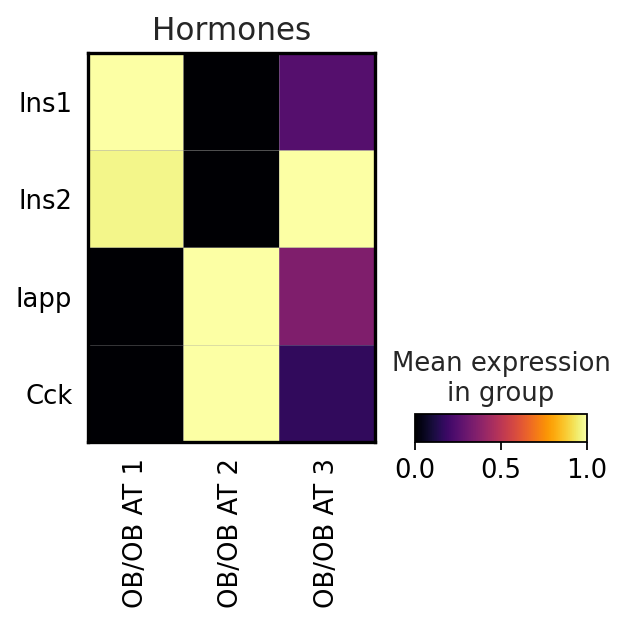

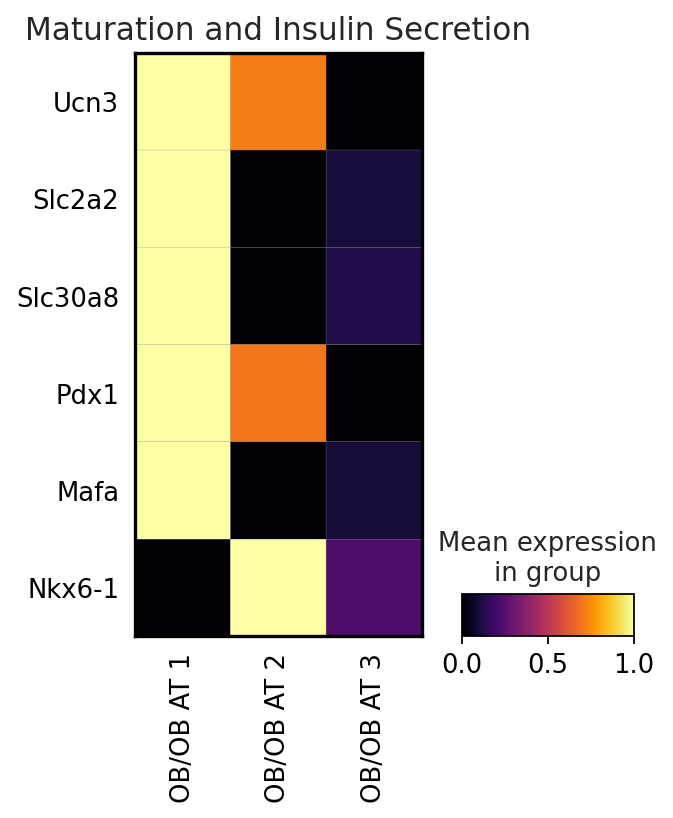

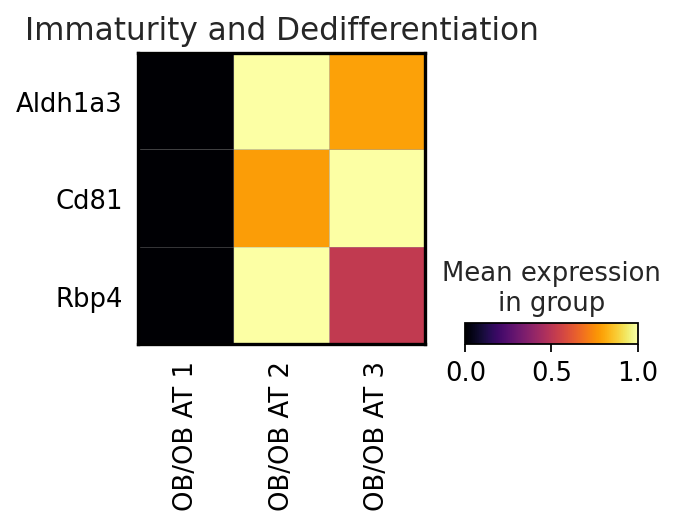

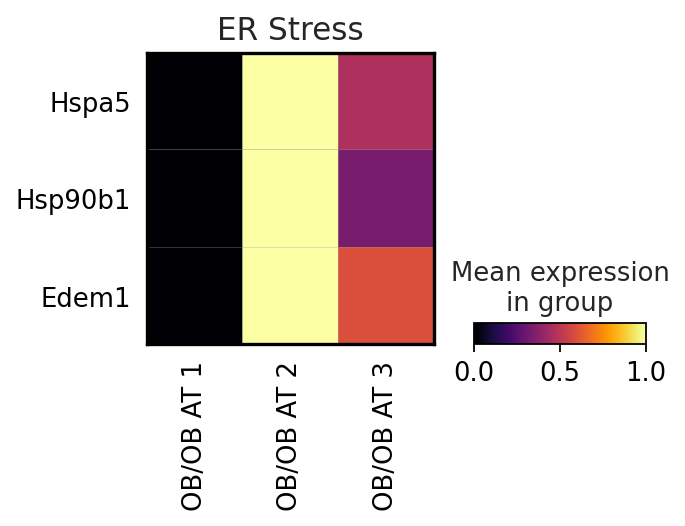

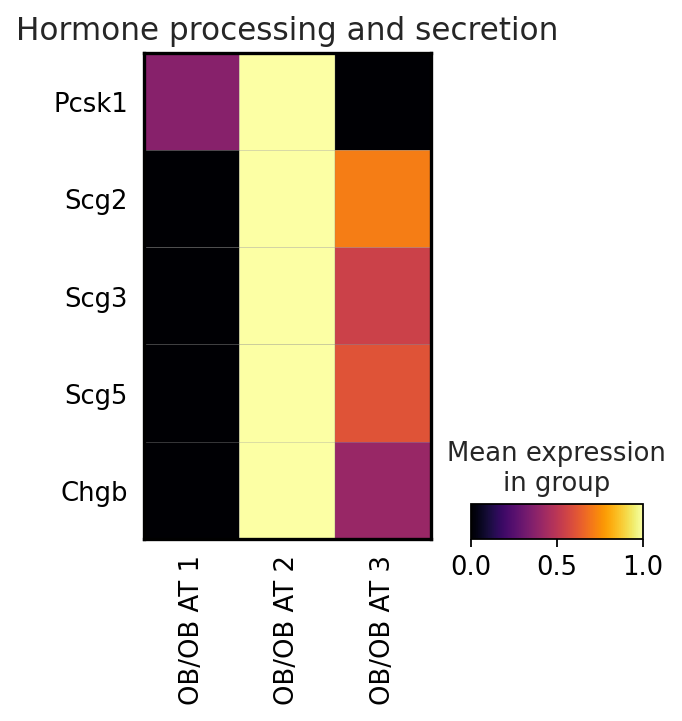

In [9]:
for key,vals in markers_dict.items():
    scanpy.pl.matrixplot(adata_beta[(adata_beta.obs['samples'] == 'OB/OB') &
                                    (adata_beta.obs['AT_committment'] != 'Uncommitted')],
                         var_names=markers_dict[key],
                         figsize=(4,len(vals)*0.8),
                         gene_symbols='names',
                         groupby=['AT_committment'],
                         standard_scale='var', cmap='inferno',
                         title=key,
                         swap_axes=True, save=f'figures/OB_OB_{key}_all_committed_cells.png')

## Visualization

In [10]:
adata_beta = scanpy.read_h5ad('../data/beta_run_2.h5ad')
adata_beta_wt = adata_beta[adata_beta.obs['samples'] == 'WT']
wt_magic_op = magic.MAGIC(random_state=42, t=10)
wt_magic = wt_magic_op.fit_transform(adata_beta_wt.to_df())
wt_magic.columns = adata_beta.var['names']

adata_beta_hfd = adata_beta[adata_beta.obs['samples'] == 'HFD']
hfd_magic_op = magic.MAGIC(random_state=42, t=10)
hfd_magic = hfd_magic_op.fit_transform(adata_beta_hfd.to_df())
hfd_magic.columns = adata_beta.var['names']

adata_beta_obob = adata_beta[adata_beta.obs['samples'] == 'OB/OB']
obob_magic_op = magic.MAGIC(random_state=42, t=10)
obob_magic = obob_magic_op.fit_transform(adata_beta_obob.to_df())
obob_magic.columns = adata_beta.var['names']

Calculating MAGIC...
  Running MAGIC on 5847 cells and 16483 genes.
  Calculating graph and diffusion operator...
    Calculating PCA...


/gpfs/gibbs/project/krishnaswamy_smita/av622/conda_envs/gspa/lib/python3.8/site-packages/magic/magic.py:425: UserWarning: Input matrix contains unexpressed genes. Please remove them prior to running MAGIC.
  warnings.warn(


    Calculated PCA in 3.63 seconds.
    Calculating KNN search...
    Calculated KNN search in 4.26 seconds.
    Calculating affinities...
    Calculated affinities in 4.29 seconds.
  Calculated graph and diffusion operator in 12.31 seconds.
  Running MAGIC with `solver='exact'` on 16483-dimensional data may take a long time. Consider denoising specific genes with `genes=<list-like>` or using `solver='approximate'`.
  Calculating imputation...
  Calculated imputation in 8.03 seconds.
Calculated MAGIC in 20.53 seconds.


In [11]:
wt_magic_pc_norm = pd.read_pickle('results/WT_magic_pc_norm.pkl')
hfd_magic_pc_norm = pd.read_pickle('results/HFD_magic_pc_norm.pkl')
obob_magic_pc_norm = pd.read_pickle('results/OB_OB_magic_pc_norm.pkl')

In [12]:
all_markers = [x for y in markers_dict.values() for x in y]

In [13]:
fig = plt.figure(figsize=(24, 18), dpi=200)

for i,gene in enumerate(all_markers):
    ax = fig.add_subplot(4, 6, i+1, projection='3d')
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_zticks([])
    ax.set_title(gene, fontsize=40)
    scprep.plot.scatter3d(np.array(wt_magic_pc_norm), c=wt_magic[gene], ticks=False,
                          azim=-150, ax=ax, fontsize=18, discrete=False)
plt.tight_layout()

fig.savefig('figures/WT_markers.png', dpi=200)

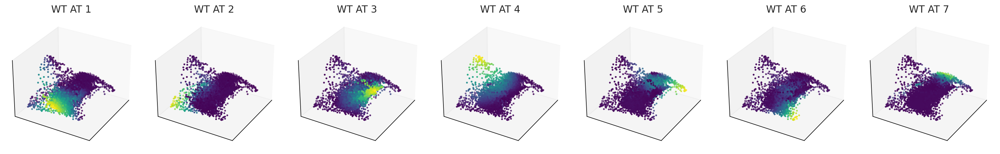

In [14]:
wt_latent = np.load('results/WT_latent_coords_7_ats.npy')
fig = plt.figure(figsize=(20,7))
for i in range(7):
    ax = fig.add_subplot(1,7,i+1, projection='3d')
    scprep.plot.scatter3d(np.array(wt_magic_pc_norm), c=wt_latent[:, i], ticks=None,
                          title=f'WT AT {i+1}', ax=ax, colorbar=False, azim=-150, cmap='viridis')
plt.tight_layout()

fig.savefig('figures/WT_archetypal_distribution_on_embedding.png', dpi=200)

In [17]:
fig = plt.figure(figsize=(24, 18), dpi=200)

for i,gene in enumerate(all_markers):
    ax = fig.add_subplot(4, 6, i+1, projection='3d')
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_zticks([])
    ax.set_title(gene, fontsize=40)
    scprep.plot.scatter3d(np.array(hfd_magic_pc_norm), c=hfd_magic[gene], ticks=False,
                          azim=-30, ax=ax, fontsize=18)
plt.tight_layout()

fig.savefig('figures/HFD_markers.png', dpi=200)

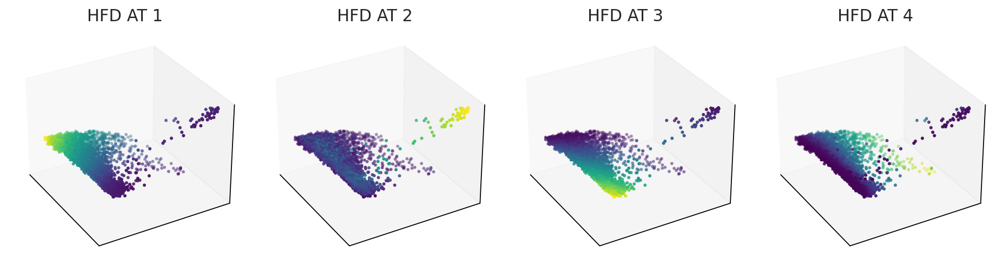

In [16]:
hfd_latent = np.load('results/HFD_latent_coords_4_ats.npy')
fig = plt.figure(figsize=(3*4,7))
for i in range(4):
    ax = fig.add_subplot(1,4,i+1, projection='3d')
    scprep.plot.scatter3d(np.array(hfd_magic_pc_norm), c=hfd_latent[:, i], ticks=None,
                          title=f'HFD AT {i+1}', ax=ax, colorbar=False, azim=-30, cmap='viridis')
plt.tight_layout()

fig.savefig('figures/HFD_archetypal_distribution_on_embedding.png', dpi=200)

In [18]:
fig = plt.figure(figsize=(24, 18), dpi=200)

for i,gene in enumerate(all_markers):
    ax = fig.add_subplot(4, 6, i+1, projection='3d')
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_zticks([])
    ax.set_title(gene, fontsize=40)
    scprep.plot.scatter3d(np.array(obob_magic_pc_norm), c=obob_magic[gene], ticks=False,
                          azim=140+300, ax=ax, fontsize=18)
plt.tight_layout()

fig.savefig('figures/OB_OB_markers.png', dpi=200)

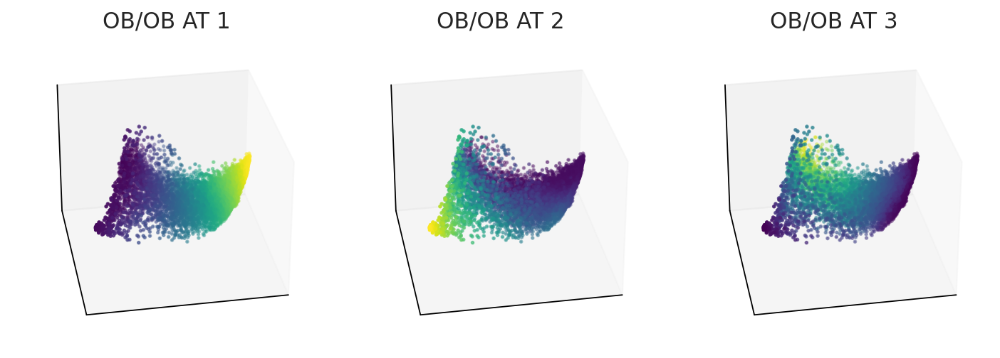

In [18]:
obob_latent = np.load('results/OB_OB_latent_coords_3_ats.npy')
fig = plt.figure(figsize=(3*3,7))
for i in range(3):
    ax = fig.add_subplot(1,3,i+1, projection='3d')
    scprep.plot.scatter3d(np.array(obob_magic_pc_norm), c=obob_latent[:, i], ticks=None,
                          title=f'OB/OB AT {i+1}', ax=ax, colorbar=False, azim=440, cmap='viridis')
plt.tight_layout()

fig.savefig('figures/OB_OB_archetypal_distribution_on_embedding.png', dpi=200)

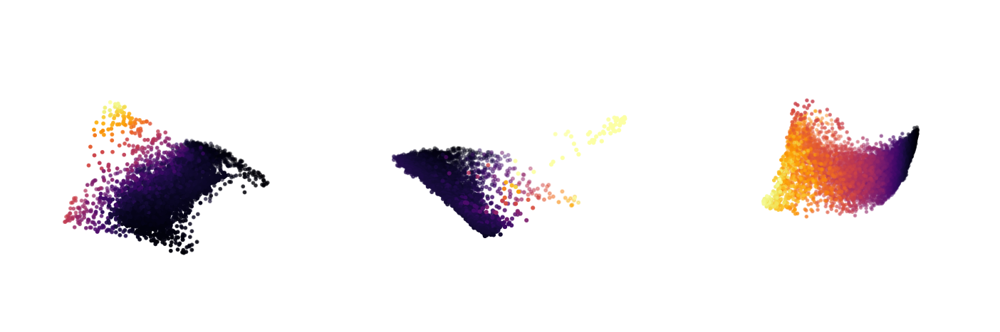

In [23]:
obob_latent = np.load('results/OB_OB_latent_coords_3_ats.npy')
fig = plt.figure(figsize=(3*3,7))
axes = []
axes.append(fig.add_subplot(1,3,1, projection='3d'))
axes.append(fig.add_subplot(1,3,2, projection='3d'))
axes.append(fig.add_subplot(1,3,3, projection='3d'))

scprep.plot.scatter3d(np.array(wt_magic_pc_norm), c=wt_magic['Neurog3'], ticks=None, ax=axes[0], colorbar=False, azim=-150)
scprep.plot.scatter3d(np.array(hfd_magic_pc_norm), c=hfd_magic['Neurog3'], ticks=None, ax=axes[1], colorbar=False, azim=-30, vmax=0.01)
scprep.plot.scatter3d(np.array(obob_magic_pc_norm), c=obob_magic['Neurog3'], ticks=None, ax=axes[2], colorbar=False, azim=440)
plt.tight_layout()
axes[0].axis('off'); axes[1].axis('off'); axes[2].axis('off')

fig.savefig('figures/ngn3_for_each_embedding.png', dpi=500)